# Imports

In [1]:
import pandas as pd
import numpy as np
import lightgbm as lgb
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.inspection import permutation_importance
import ta

from tqdm.notebook import tqdm
tqdm.pandas()

import matplotlib.pyplot as plt
import plotly.express as px

from sklearn.metrics import f1_score
from imblearn.under_sampling import RandomUnderSampler
pd.set_option('display.float_format', lambda x: '%.3f' % x)
np.set_printoptions(suppress=True)
from pprint import pprint

import gc
import optuna
from sklearn.feature_selection import RFE


/tmp/ipykernel_22184/384002432.py:1: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


In [2]:
df = pd.read_csv('./pair_features_1_pairs500_300_120.csv')
df.head()

,Ticker_P1,Date,High_P1,Low_P1,Volume_P1,Close_P1,Ticker_P2,High_P2,Low_P2,Volume_P2,Close_P2,abs_spread,abs_spread_mean,abs_spread_std,abs_spread_mean_MA,abs_spread_std_MA,pnls,actual_abs_spread,actual_abs_spread_std
0,OXY,2001-02-09 00:00:00,11.784,11.348,2194431.000,6.254,ABT,21.956,21.462,7686775.000,12.783,6.529,5.589,1.512,6.928,1.157,0.000,5.727,0.776
1,OXY,2001-02-12 00:00:00,11.712,11.492,2170216.000,6.239,ABT,22.221,21.861,9060129.000,13.074,6.835,5.597,1.512,6.907,1.147,0.000,5.700,0.765
2,OXY,2001-02-13 00:00:00,11.660,11.434,1830363.000,6.200,ABT,21.839,21.314,10283116.000,12.588,6.387,5.605,1.510,6.868,1.124,0.000,5.679,0.763
3,OXY,2001-02-14 00:00:00,11.736,11.478,1511177.000,6.195,ABT,21.543,21.220,4029175.000,12.522,6.326,5.611,1.509,6.831,1.103,0.000,5.664,0.759
4,OXY,2001-02-15 00:00:00,11.621,11.449,2141825.000,6.180,ABT,21.525,20.825,6862762.000,12.664,6.484,5.619,1.508,6.799,1.086,0.000,5.647,0.752


In [3]:
total_days = df.Date.nunique()
total_days

5698

In [4]:
df.pnls.describe()

count   2849000.000
mean          0.002
std           0.053
min          -1.483
25%           0.000
50%           0.000
75%           0.017
max           2.320
Name: pnls, dtype: float64

In [5]:
class feature_engineering(object):
    def __init__(self):
        super(feature_engineering, self).__init__()

    def generate_technical_indicator(self, data_df): 
        '''
        Function to generate additional technical indicators for the stock

        Uses the "statsmodels.tsa.stattools" (as "ts") package to apply 
        the equations specified in the "Technical Indicators" markdown section 
        to stock closing data.
        
        Input:
        data_df-- Dataframe containing stock finacials data
        
        Output:
        Stock finacials data with added Dataframe of feature obtained from feature engineering
        ''' 
        # 1. Momentum Indicators
        # Relative Strength Index
        df = data_df
        df['rsi'] = ta.momentum.rsi(df['Close'], window=14)
        # Kaufman’s Adaptive Moving Average (KAMA)
        df['kama'] = ta.momentum.kama(df['Close'],window=14)

        # 2. Volume Indicators
        # Accumulation/Distribution Index (ADI)
        df['adi'] = ta.volume.acc_dist_index(df['High'], df['Low'], df['Close'], df['Volume'])

        # Volume-price trend (VPT)
        df['vpt'] = ta.volume.volume_price_trend(df['Close'], df['Volume'])

        # 3. Volatility Indicators
        # Average True Range (ATR)
        df['atr'] = ta.volatility.average_true_range(df['High'], df['Low'],df['Close'], window=14)

        # Bollinger Bands (BB) N-period simple moving average (MA)
        df['bb_ma'] = ta.volatility.bollinger_mavg(df['Close'], window=20)

        # 4. Trend Indicators
        # Average Directional Movement Index (ADX)
        df['adx'] = ta.trend.adx(df['High'], df['Low'], df['Close'], window=14)

        # Exponential Moving Average
        df['ema'] = ta.trend.ema_indicator(df['Close'], window=14)

        # Moving Average Convergence Divergence (MACD)
        df['macd'] = ta.trend.macd(df['Close'], window_fast=14, window_slow=30)

        # 5. Other Indicators
        # Daily Log Return (DLR)
        df['dlr'] = ta.others.daily_log_return(df['Close'])

        # Daily Returns
        df['daily_returns'] = df['Close'].pct_change()

        # Moving Averages
        averages = [50,200]
        for avg in averages:
            col_name = str(avg) +' Days Average'
            df[col_name] = df['Close'].rolling(window = avg, center = False).mean()

        return df

In [6]:
pd.to_datetime(df['Date']).dt.date

0          2001-02-09
1          2001-02-12
2          2001-02-13
3          2001-02-14
4          2001-02-15
              ...    
2848995    2023-09-28
2848996    2023-09-29
2848997    2023-10-02
2848998    2023-10-03
2848999    2023-10-04
Name: Date, Length: 2849000, dtype: object

In [7]:
spy_df = pd.read_csv('/home/ec2-user/Capstone/1999-12-01-2023-12-31_SPY.csv')
spy_df = spy_df[['Date','Adj Close']]
spy_df.columns = ['Date','SPY_Close']
df['Date'] = pd.to_datetime(df['Date']).dt.date

spy_df['Date'] = pd.to_datetime(spy_df['Date']).dt.date
df = pd.merge(df,spy_df,on='Date',how='left')

In [8]:
fe_obj = feature_engineering()

### Beta

In [9]:
all_tickers = df['Ticker_P1'].unique().tolist()+df['Ticker_P2'].unique().tolist()
len(all_tickers)

359

In [10]:
def compute_beta(rs,df,ticker,market):
    rows = df.loc[rs.index]
    sec_returns = np.log( df[[ticker,market]] / df[[ticker,market]].shift(1) ) 

    cov = sec_returns.cov() * 250
    cov_with_market = cov.iloc[0,1]
    market_var = sec_returns[market].var() * 250
    beta = cov_with_market / market_var
    return beta

In [11]:
all_tickers_df_list = []
for t in tqdm(all_tickers):
    single_ticker_df = (df[df['Ticker_P1']==t] if t in df['Ticker_P1'].unique() else df[df['Ticker_P2']==t])
    single_ticker_df = single_ticker_df.sort_values('Date')
    single_ticker_df = single_ticker_df[['Date','Ticker_P1','Close_P1','High_P1','Low_P1','Volume_P1','SPY_Close']] if t in df['Ticker_P1'].unique() else\
                       single_ticker_df[['Date','Ticker_P2','Close_P2','High_P2','Low_P2','Volume_P2','SPY_Close']]
    single_ticker_df.columns = ['Date','Ticker','Close','High','Low','Volume','SPY_Close']
    single_ticker_df = single_ticker_df.drop_duplicates()

    single_ticker_df['rolling_beta'] = single_ticker_df['Close'].rolling(300).progress_apply(compute_beta, \
                                        args=(single_ticker_df,'Close','SPY_Close'))

    single_ticker_df_with_technical_indicators = fe_obj.generate_technical_indicator(single_ticker_df)
    



    
    all_tickers_df_list.append(single_ticker_df_with_technical_indicators)


  0%|          | 0/359 [00:00<?, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

### Single Ticker Features

In [12]:
df.columns

Index(['Ticker_P1', 'Date', 'High_P1', 'Low_P1', 'Volume_P1', 'Close_P1',
       'Ticker_P2', 'High_P2', 'Low_P2', 'Volume_P2', 'Close_P2', 'abs_spread',
       'abs_spread_mean', 'abs_spread_std', 'abs_spread_mean_MA',
       'abs_spread_std_MA', 'pnls', 'actual_abs_spread',
       'actual_abs_spread_std', 'SPY_Close'],
      dtype='object')

In [13]:
df.sort_values('Date')

,Ticker_P1,Date,High_P1,Low_P1,Volume_P1,Close_P1,Ticker_P2,High_P2,Low_P2,Volume_P2,Close_P2,abs_spread,abs_spread_mean,abs_spread_std,abs_spread_mean_MA,abs_spread_std_MA,pnls,actual_abs_spread,actual_abs_spread_std,SPY_Close
0,OXY,2001-02-09,11.784,11.348,2194431.000,6.254,ABT,21.956,21.462,7686775.000,12.783,6.529,5.589,1.512,6.928,1.157,0.000,5.727,0.776,86.000
1777776,OXY,2001-02-09,11.784,11.348,2194431.000,6.254,JBHT,4.781,4.656,1077600.000,3.859,2.395,2.383,0.442,2.455,0.449,-0.012,3.339,0.478,86.000
2678060,ABT,2001-02-09,21.956,21.462,7686775.000,12.783,HRL,5.438,5.258,887200.000,3.465,9.319,8.123,1.744,9.776,0.996,0.000,9.081,0.394,86.000
1772078,OXY,2001-02-09,11.784,11.348,2194431.000,6.254,WMB,32.591,31.640,3602441.000,13.356,7.102,7.094,1.520,6.008,0.878,0.061,6.752,0.540,86.000
1766380,OXY,2001-02-09,11.784,11.348,2194431.000,6.254,FITB,58.188,57.062,1103800.000,29.849,23.595,18.582,3.203,22.981,1.761,0.000,20.970,1.415,86.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1931621,OXY,2023-10-04,61.580,59.340,15878800.000,59.849,WFC,39.110,38.390,14343500.000,38.356,21.492,21.377,3.802,20.710,3.044,0.000,17.915,5.442,422.945
1937319,OXY,2023-10-04,61.580,59.340,15878800.000,59.849,DHI,104.800,102.800,3115800.000,103.913,44.064,33.109,20.275,55.602,8.426,-0.065,62.818,19.141,422.945
1943017,OXY,2023-10-04,61.580,59.340,15878800.000,59.849,AJG,229.650,225.740,656900.000,228.186,168.338,134.079,19.011,160.462,5.250,0.017,175.602,10.178,422.945
1868943,OXY,2023-10-04,61.580,59.340,15878800.000,59.849,CTRA,26.290,25.440,7253800.000,25.640,34.209,37.402,3.271,35.835,1.509,0.000,34.132,1.305,422.945


In [14]:
all_tickers_df = pd.concat(all_tickers_df_list,axis=0,ignore_index=True).reset_index(drop=True)
all_tickers_df.shape

(2045582, 21)

In [15]:
print(df.shape)
all_tickers_df_P1_suffix = all_tickers_df.copy()
all_tickers_df_P1_suffix.columns = ['Date','Ticker']+[c+'_P1' for c in all_tickers_df.columns if c not in ['Date','Ticker']]
all_tickers_df_P2_suffix = all_tickers_df.copy()
all_tickers_df_P2_suffix.columns = ['Date','Ticker']+[c+'_P2' for c in all_tickers_df.columns if c not in ['Date','Ticker']]

df = pd.merge(df,all_tickers_df_P1_suffix,left_on=['Date','Ticker_P1'],right_on=['Date','Ticker'],\
              how='left',suffixes=['','_P1']).drop_duplicates()
print(df.shape)
df = pd.merge(df,all_tickers_df_P2_suffix,left_on=['Date','Ticker_P2'],right_on=['Date','Ticker'],\
              how='left',suffixes=['','_P2']).drop_duplicates()
print(df.shape)
df = df.loc[:,~df.columns.duplicated()]
print(df.shape)


(2849000, 20)
(2849000, 40)
(2849000, 60)
(2849000, 59)


In [16]:
# for i in [1,20,30,60,90]:
#     for c in ['num_entries','pnls']:
#         df['PREV_'+str(i)+'_'+c] = df.groupby(['Ticker_P1','Ticker_P2'])[c].shift(20+i)

In [17]:
# for c in ['num_entries','pnls']:
#     df['PREV_'+c+'_mean'] = df[['PREV_1_'+c,'PREV_20_'+c,'PREV_30_'+c,'PREV_60_'+c,'PREV_90_'+c]].mean(axis=1)

In [18]:
df['rsi_abs_spread'] = ta.momentum.rsi(df['abs_spread'], window=14)
# Kaufman’s Adaptive Moving Average (KAMA)
df['kama_abs_spread'] = ta.momentum.kama(df['abs_spread'],window=14)

# 2. Volume Indicators
# Accumulation/Distribution Index (ADI)
# df['adi'] = ta.volume.acc_dist_index(df['High'], df['Low'], df['Close'], df['Volume'])

# Volume-price trend (VPT)
df['vpt_abs_spread'] = ta.volume.volume_price_trend(df['abs_spread'], np.log(df['Volume_P1'])+np.log(df['Volume_P2']))

# 3. Volatility Indicators
# Average True Range (ATR)
# df['atr'] = ta.volatility.average_true_range(df['High'], df['Low'],df['Close'], window=14)

# Bollinger Bands (BB) N-period simple moving average (MA)
df['bb_ma_abs_spread'] = ta.volatility.bollinger_mavg(df['abs_spread'], window=20)

# 4. Trend Indicators
# Average Directional Movement Index (ADX)
# df['adx'] = ta.trend.adx(df['High'], df['Low'], df['Close'], window=14)

# Exponential Moving Average
df['ema_abs_spread'] = ta.trend.ema_indicator(df['abs_spread'], window=14)

# Moving Average Convergence Divergence (MACD)
df['macd_abs_spread'] = ta.trend.macd(df['abs_spread'], window_fast=14, window_slow=30)

# 5. Other Indicators
# Daily Log Return (DLR)
df['dlr_abs_spread'] = ta.others.daily_log_return(df['abs_spread'])

# Daily Returns
df['daily_returns_abs_spread'] = df['abs_spread'].pct_change()

# Moving Averages
averages = [50,200]
for avg in averages:
    col_name = str(avg) +' Days Average abs_spread'
    df[col_name] = df['abs_spread'].rolling(window = avg, center = False).mean()

/opt/tensorflow/lib/python3.10/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/opt/tensorflow/lib/python3.10/site-packages/numpy/core/fromnumeric.py:57: RuntimeWarning: invalid value encountered in accumulate
  return bound(*args, **kwds)
/opt/tensorflow/lib/python3.10/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


In [19]:
for c in ['Close', 'High', 'Low', 'Volume', 'rolling_beta', 'rsi', 'kama',
       'adi', 'vpt', 'atr', 'bb_ma', 'adx', 'ema', 'macd', 'dlr',
       'daily_returns', '50 Days Average', '200 Days Average']:
# ,
#        'sector_rolling_beta_mean', 'sector_rolling_beta_std',
#        'sector_daily_return_mean', 'sector_daily_return_std']:
    df['DIFF_'+c] = df[c+'_P1'] - df[c+'_P2']

In [20]:
# # df['PCT_abs_spread_mean_l28_300'] = (df['abs_spread_mean_l28'] - df['abs_spread_mean'])/df['abs_spread_mean']
# df['PCT_abs_spread_normed_median_l7'] = (df['abs_spread_normed_median'] - df['abs_spread_normed_l7_avg'])/df['abs_spread_normed_median']
# df['PCT_abs_spread_normed_median_l4'] = (df['abs_spread_normed_median'] - df['abs_spread_normed_l14_avg'])/df['abs_spread_normed_median']

In [21]:
df['PCT_rolling_beta_P1'] = (df['rolling_beta_P1']-df.groupby('Ticker_P1')['rolling_beta_P1'].shift(20))/df.groupby('Ticker_P1')['rolling_beta_P1'].shift(20)
df['PCT_rolling_beta_P2'] = (df['rolling_beta_P2']-df.groupby('Ticker_P2')['rolling_beta_P2'].shift(20))/df.groupby('Ticker_P2')['rolling_beta_P2'].shift(20)
df['DIFF_secondary_rolling_beta'] = df['PCT_rolling_beta_P1']-df['PCT_rolling_beta_P2']

In [22]:
stock2vec = pd.read_csv('/home/ec2-user/Capstone/stock2vec.csv')
stock2vec.head()

,STOCK2VEC_0,STOCK2VEC_1,STOCK2VEC_2,STOCK2VEC_3,STOCK2VEC_4,STOCK2VEC_5,STOCK2VEC_6,STOCK2VEC_7,STOCK2VEC_8,STOCK2VEC_9,...,STOCK2VEC_23,STOCK2VEC_24,STOCK2VEC_25,STOCK2VEC_26,STOCK2VEC_27,STOCK2VEC_28,STOCK2VEC_29,STOCK2VEC_30,STOCK2VEC_31,Ticker
0,-0.132,0.010,0.005,-0.073,-0.040,0.019,0.119,0.108,0.025,0.052,...,-0.110,-0.028,-0.002,0.084,0.059,0.005,0.072,0.040,-0.005,NaN
1,-0.262,0.137,-0.033,0.054,0.176,0.252,-0.076,0.028,-0.037,-0.339,...,-0.243,0.309,-0.047,0.231,0.184,-0.067,-0.213,-0.019,0.211,[UNK]
2,-0.430,0.123,-0.114,0.116,-0.037,0.241,-0.080,-0.119,0.102,-0.521,...,0.120,0.909,0.054,0.102,0.213,-0.060,-0.047,-0.035,0.026,ZION
3,-0.700,-0.057,-0.120,0.097,0.098,0.105,0.071,-0.231,-0.029,-0.487,...,0.077,0.846,-0.004,-0.008,0.148,-0.038,0.003,0.029,0.045,ZBRA
4,-0.915,0.049,0.050,0.110,-0.087,0.232,0.027,-0.143,-0.043,-0.252,...,-0.086,0.654,0.043,0.076,0.072,-0.003,0.007,-0.045,0.025,ZBH


In [23]:
stock2vec.columns = [c + '_P1' for c in stock2vec.columns]
df = pd.merge(df,stock2vec,on='Ticker_P1',how='left')
stock2vec.columns = [c[:-3] + '_P2' for c in stock2vec.columns]
df = pd.merge(df,stock2vec,on='Ticker_P2',how='left')
df.tail(2)

,Ticker_P1,Date,High_P1,Low_P1,Volume_P1,Close_P1,Ticker_P2,High_P2,Low_P2,Volume_P2,...,STOCK2VEC_22_P2,STOCK2VEC_23_P2,STOCK2VEC_24_P2,STOCK2VEC_25_P2,STOCK2VEC_26_P2,STOCK2VEC_27_P2,STOCK2VEC_28_P2,STOCK2VEC_29_P2,STOCK2VEC_30_P2,STOCK2VEC_31_P2
2848998,ABT,2023-10-03,96.170,94.580,4597500.000,94.805,MU,69.650,67.110,12481500.000,...,0.068,-0.047,0.198,0.069,-0.136,0.251,-0.016,0.069,0.052,0.116
2848999,ABT,2023-10-04,96.340,94.830,4336100.000,94.666,MU,68.500,67.120,12912800.000,...,0.068,-0.047,0.198,0.069,-0.136,0.251,-0.016,0.069,0.052,0.116


In [24]:
from numpy.linalg import norm


In [25]:
# Can be a lot faster if we do it on pair level first then merge.

vec1_sub1 = df[['STOCK2VEC_'+ str(i) + '_P1' for i in range(0,32)]]
vec2_sub1 = df[['STOCK2VEC_'+ str(i) + '_P2' for i in range(0,32)]]
cs = [np.dot(vec1_sub1.iloc[i], vec2_sub1.iloc[i]) / (norm(vec1_sub1.iloc[i]) * norm(vec2_sub1.iloc[i])) for i in tqdm(range(len(vec1_sub1)))]


  0%|          | 0/2849000 [00:00<?, ?it/s]

In [26]:
df['stock2vec_cos_sim'] = cs

In [27]:
df = df.sort_values('Date')

In [28]:

for i in range(1,4):
    df['FUTURE_abs_spread_'+str(i)] = df.groupby(['Ticker_P1','Ticker_P2'])['abs_spread'].shift(-1*i)

df['FUTURE_abs_spread_avg'] = df[[c for c in df.columns if 'FUTURE_abs_spread_' in c]].mean(axis=1)

# df['PCT_CHANGE'] = (df['FUTURE_abs_spread_avg'] - df['abs_spread'])*100.0/df['abs_spread']
# df['direction'] = np.where(df['PCT_CHANGE'].abs()<3,0,np.where(df['PCT_CHANGE']>0,1,-1))
# df['direction'] = np.where((df['FUTURE_abs_spread_avg'] - (df['abs_spread_mean']+1.5*df['abs_spread_std']))>0,1,0)
df['entry_label1'] = np.where((df['FUTURE_abs_spread_avg'] - (df['abs_spread_mean']+1.5*df['abs_spread_std']))>0,1,0)

df['entry_label1'].value_counts()
# df['direction'] = df['PCT_CHANGE']

entry_label1
0    2207353
1     641647
Name: count, dtype: int64

In [29]:

for i in range(9,12):
    df['FUTURE_abs_spread_'+str(i)] = df.groupby(['Ticker_P1','Ticker_P2'])['abs_spread'].shift(-1*i)

df['FUTURE_abs_spread_avg'] = df[[c for c in df.columns if 'FUTURE_abs_spread_' in c]].mean(axis=1)

# df['PCT_CHANGE'] = (df['FUTURE_abs_spread_avg'] - df['abs_spread'])*100.0/df['abs_spread']
# df['direction'] = np.where(df['PCT_CHANGE'].abs()<3,0,np.where(df['PCT_CHANGE']>0,1,-1))
# df['direction'] = np.where((df['FUTURE_abs_spread_avg'] - (df['abs_spread_mean']+1.5*df['abs_spread_std']))>0,1,0)
df['exit_label1'] = np.where((df['FUTURE_abs_spread_avg'] - (df['abs_spread_mean']+0.1*df['abs_spread_std']))<0,1,0)

df['exit_label1'].value_counts()
# df['direction'] = df['PCT_CHANGE']

exit_label1
0    1575772
1    1273228
Name: count, dtype: int64

In [30]:
df = df.drop([c for c in df.columns if 'FUTURE_abs_spread_' in c]+['FUTURE_abs_spread_avg'],axis=1)

In [31]:
print(df.shape)
df = df.drop('vpt_abs_spread',axis=1)
print(df.shape)


(2849000, 157)
(2849000, 156)


In [32]:
df.replace([np.inf, -np.inf], np.nan).isna().sum().sort_values(ascending=False)

PCT_rolling_beta_P1            159500
PCT_rolling_beta_P2            159500
DIFF_secondary_rolling_beta    159500
rolling_beta_P1                149500
rolling_beta_P2                149500
                                ...  
SPY_Close_P2                        0
Volume_P2_P2                        0
Low_P2_P2                           0
High_P2_P2                          0
exit_label1                         0
Length: 156, dtype: int64

In [33]:
# stop

In [34]:
print(df.shape)
df = df.replace([np.inf, -np.inf], np.nan).dropna()
df.shape

(2849000, 156)


(2599602, 156)

In [35]:
# X['abs_spread_log_mean_MA'] = np.log(X['abs_spread_mean_MA'])
# X['abs_spread_log_std_mean_MA'] = np.log(X['abs_spread_std_MA'])
# X = X.drop(['abs_spread_mean_MA', 'abs_spread_std_MA'],axis=1)
# X

# Entry model

In [36]:
label = 'entry_label1'
features_to_exclude = [] # ['High_P1', 'High_P2', 'Low_P1', 'Low_P2', 'abs_spread', 'abs_spread_mean', 'abs_spread_std']
always_exclude = ['pnls', 'actual_abs_spread_std','actual_abs_spread','exit_label1']
X = df
y = df[label]

X = X.drop(['Date', 'Ticker_P1', 'Ticker_P2', 'Volume_P1', 'Volume_P2', 'SPY_Close','Ticker',label]+\
           ['STOCK2VEC_'+ str(i) + '_P1' for i in range(0,32)]+\
           ['STOCK2VEC_'+ str(i) + '_P2' for i in range(0,32)],axis=1)
X = X.drop(always_exclude, axis=1)
X = X.drop(features_to_exclude, axis=1)

In [37]:
X['abs_spread_log_mean_MA'] = np.log(X['abs_spread_mean_MA'])
X['abs_spread_log_std_mean_MA'] = np.log(X['abs_spread_std_MA'])
X = X.drop(['abs_spread_mean_MA', 'abs_spread_std_MA'],axis=1)
X

,High_P1,Low_P1,Close_P1,High_P2,Low_P2,Close_P2,abs_spread,abs_spread_mean,abs_spread_std,Close_P1_P1,...,DIFF_dlr,DIFF_daily_returns,DIFF_50 Days Average,DIFF_200 Days Average,PCT_rolling_beta_P1,PCT_rolling_beta_P2,DIFF_secondary_rolling_beta,stock2vec_cos_sim,abs_spread_log_mean_MA,abs_spread_log_std_mean_MA
832227,14.711,14.333,8.224,19.650,16.580,18.990,10.766,19.014,4.076,8.224,...,-9.150,-0.098,-13.712,-17.702,0.000,0.000,0.000,0.613,2.668,1.125
1231087,14.711,14.333,8.224,42.130,41.300,26.776,18.552,17.196,2.470,8.224,...,1.504,0.015,-19.951,-17.719,0.000,0.000,0.000,0.811,2.995,-0.301
410575,14.711,14.333,8.224,10.297,10.099,5.606,2.618,2.163,0.440,8.224,...,1.348,0.014,2.096,2.085,0.000,0.000,0.000,0.893,0.726,-1.732
558723,14.711,14.333,8.224,29.530,28.780,11.758,3.534,2.930,0.933,8.224,...,0.100,0.001,-3.732,-3.437,0.000,0.000,0.000,0.848,1.320,-1.798
986073,14.711,14.333,8.224,14.260,13.560,10.806,2.582,5.761,3.360,8.224,...,1.459,0.015,-5.562,-5.417,0.000,0.000,0.000,0.855,1.787,0.625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1931621,61.580,59.340,59.849,39.110,38.390,38.356,21.492,21.377,3.802,59.849,...,-4.724,-0.047,21.583,20.112,0.000,0.000,0.000,0.878,3.031,1.113
1937319,61.580,59.340,59.849,104.800,102.800,103.913,44.064,33.109,20.275,59.849,...,-5.419,-0.054,-53.420,-45.175,0.000,0.000,0.000,0.761,4.018,2.131
1943017,61.580,59.340,59.849,229.650,225.740,228.186,168.338,134.079,19.011,59.849,...,-5.729,-0.057,-161.672,-143.562,0.000,0.000,0.000,0.810,5.078,1.658
1868943,61.580,59.340,59.849,26.290,25.440,25.640,34.209,37.402,3.271,59.849,...,-1.996,-0.019,36.115,36.300,0.000,0.000,0.000,0.863,3.579,0.411


In [38]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42,shuffle=False)
X_val, X_test, y_val, y_test = train_test_split(X_test, y_test, test_size=0.5, random_state=42,shuffle=False)

In [39]:
print(df.loc[X_train.index].Date.min(),df.loc[X_train.index].Date.max())

2002-05-23 2019-06-20


In [40]:
print(df.loc[X_val.index].Date.min(),df.loc[X_val.index].Date.max())

2019-06-20 2021-08-11


In [41]:
print(df.loc[X_test.index].Date.min(),df.loc[X_test.index].Date.max())

2021-08-11 2023-10-04


In [42]:
undersample = RandomUnderSampler(sampling_strategy='majority')
X_train, y_train = undersample.fit_resample(X_train, y_train)
X_val, y_val = undersample.fit_resample(X_val, y_val)

In [43]:
def objective(trial):
    params = {
        'boosting':'dart',
        "objective": "binary",
#         "metric": "accuracy",
#         'class_weight':'balanced',
        "n_estimators": 300,
        "verbosity": -1,
        "bagging_freq": 1,
        'max_bin':trial.suggest_int('max_bin',64,1024),
        'max_depth':trial.suggest_int('max_depth',4,20),

        "learning_rate": trial.suggest_float("learning_rate", 1e-4, 0.2, log=True),
        "num_leaves": trial.suggest_int("num_leaves", 2, 3000),
        "subsample": trial.suggest_float("subsample", 0.05, 1.0),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.05, 1.0),
        "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 1, 1000),
    }

    model = lgb.LGBMClassifier(**params)
    model.fit(X_train,y_train)
    predictions = model.predict(X_val)
    f1 = f1_score(y_val, predictions, average='weighted')
    return -1*f1

In [44]:
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=10)

[I 2024-03-27 21:07:04,458] A new study created in memory with name: no-name-dc4945b3-56ac-41b6-a8ff-c290a075e138
[I 2024-03-27 21:08:38,899] Trial 0 finished with value: -0.8679086938694437 and parameters: {'max_bin': 712, 'max_depth': 12, 'learning_rate': 0.05983232048149978, 'num_leaves': 2204, 'subsample': 0.6141976980496876, 'colsample_bytree': 0.690191481471382, 'min_data_in_leaf': 77}. Best is trial 0 with value: -0.8679086938694437.
[I 2024-03-27 21:09:35,215] Trial 1 finished with value: -0.8088664266687515 and parameters: {'max_bin': 766, 'max_depth': 10, 'learning_rate': 0.00014344312139389595, 'num_leaves': 1162, 'subsample': 0.2787071851832218, 'colsample_bytree': 0.4270894307142255, 'min_data_in_leaf': 184}. Best is trial 0 with value: -0.8679086938694437.
[I 2024-03-27 21:11:14,847] Trial 2 finished with value: -0.8215637446791705 and parameters: {'max_bin': 977, 'max_depth': 13, 'learning_rate': 0.010082974781804246, 'num_leaves': 1784, 'subsample': 0.6510416756451929, 

In [45]:
print('Best hyperparameters:', study.best_params)
print('Best F1:', study.best_value*(-1))

Best hyperparameters: {'max_bin': 237, 'max_depth': 16, 'learning_rate': 0.09586190185858892, 'num_leaves': 2883, 'subsample': 0.9965124540786066, 'colsample_bytree': 0.33760066727116306, 'min_data_in_leaf': 252}
Best F1: 0.8782485846779013


In [46]:
hyper_params = study.best_params

In [47]:
hyper_params = study.best_params
hyper_params['boosting']='dart'
hyper_params["objective"] = "binary"
# hyper_params["metric"] = 'l2'
#         'class_weight':'balanced',
hyper_params["n_estimators"] = 300

In [48]:
y_train.value_counts()/len(y_train)

entry_label1
0   0.500
1   0.500
Name: count, dtype: float64

In [49]:
gbm = lgb.LGBMClassifier(**hyper_params)
callbacks = [\
#             lgb.early_stopping(stopping_rounds=10, verbose=1,min_delta=0.001,first_metric_only=False), 
             lgb.log_evaluation(period=1)]

gbm.fit(X_train,y_train, 
        eval_set=[(X_val, y_val)],
        eval_metric='accuracy',
        callbacks=callbacks,
        feature_name = X_train.columns.tolist(),
#         categorical_feature=categorical_features
       )

[LightGBM] [Warning] min_data_in_leaf is set=252, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=252
[LightGBM] [Warning] boosting is set=dart, boosting_type=gbdt will be ignored. Current value: boosting=dart
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] min_data_in_leaf is set=252, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=252
[LightGBM] [Warning] boosting is set=dart, boosting_type=gbdt will be ignored. Current value: boosting=dart
[LightGBM] [Info] Number of positive: 472883, number of negative: 472883
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007181 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 18006
[LightGBM] [Info] Number of data points in the train set: 945766, number of used features: 77
[LightGBM] [Warning] min_dat

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[61]	valid_0's binary_logloss: 0.338374
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[62]	valid_0's binary_logloss: 0.336623
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[63]	valid_0's binary_logloss: 0.334198
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[64]	valid_0's binary_logloss: 0.335306
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[65]	valid_0's binary_logloss: 0.336947
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[66]	valid_0's binary_logloss: 0.33414
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[67]	valid_0's binary_logloss: 0.333049
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[68]	valid_0's binary_logloss: 0.33045
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[69]	va

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[134]	valid_0's binary_logloss: 0.308782
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[135]	valid_0's binary_logloss: 0.308406
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[136]	valid_0's binary_logloss: 0.309279
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[137]	valid_0's binary_logloss: 0.309767
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[138]	valid_0's binary_logloss: 0.307546
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[139]	valid_0's binary_logloss: 0.30679
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[140]	valid_0's binary_logloss: 0.307502
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[141]	valid_0's binary_logloss: 0.307904
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[205]	valid_0's binary_logloss: 0.295659
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[206]	valid_0's binary_logloss: 0.294093
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[207]	valid_0's binary_logloss: 0.294375
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[208]	valid_0's binary_logloss: 0.293903
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[209]	valid_0's binary_logloss: 0.294213
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[210]	valid_0's binary_logloss: 0.294468
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[211]	valid_0's binary_logloss: 0.294744
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[212]	valid_0's binary_logloss: 0.294351
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[276]	valid_0's binary_logloss: 0.277099
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[277]	valid_0's binary_logloss: 0.276921
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[278]	valid_0's binary_logloss: 0.277083
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[279]	valid_0's binary_logloss: 0.276088
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[280]	valid_0's binary_logloss: 0.276192
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[281]	valid_0's binary_logloss: 0.27631
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[282]	valid_0's binary_logloss: 0.275926
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[283]	valid_0's binary_logloss: 0.276182
[LightGBM] [Warning] No further splits with positive gain, best gain: -in

LGBMClassifier(boosting='dart', colsample_bytree=0.33760066727116306,
               learning_rate=0.09586190185858892, max_bin=237, max_depth=16,
               min_data_in_leaf=252, n_estimators=300, num_leaves=2883,
               objective='binary', subsample=0.9965124540786066)

In [50]:
entry_preds = gbm.predict(X_test)

[LightGBM] [Warning] min_data_in_leaf is set=252, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=252
[LightGBM] [Warning] boosting is set=dart, boosting_type=gbdt will be ignored. Current value: boosting=dart


# Exit model

In [51]:
label = 'exit_label1'
features_to_exclude = [] # ['High_P1', 'High_P2', 'Low_P1', 'Low_P2', 'abs_spread', 'abs_spread_mean', 'abs_spread_std']
always_exclude = ['pnls', 'actual_abs_spread_std','actual_abs_spread','entry_label1']
X = df
y = df[label]

X = X.drop(['Date', 'Ticker_P1', 'Ticker_P2', 'Volume_P1', 'Volume_P2', 'SPY_Close','Ticker',label]+\
           ['STOCK2VEC_'+ str(i) + '_P1' for i in range(0,32)]+\
           ['STOCK2VEC_'+ str(i) + '_P2' for i in range(0,32)],axis=1)
X = X.drop(always_exclude, axis=1)
X = X.drop(features_to_exclude, axis=1)

In [52]:
X['abs_spread_log_mean_MA'] = np.log(X['abs_spread_mean_MA'])
X['abs_spread_log_std_mean_MA'] = np.log(X['abs_spread_std_MA'])
X = X.drop(['abs_spread_mean_MA', 'abs_spread_std_MA'],axis=1)
X

,High_P1,Low_P1,Close_P1,High_P2,Low_P2,Close_P2,abs_spread,abs_spread_mean,abs_spread_std,Close_P1_P1,...,DIFF_dlr,DIFF_daily_returns,DIFF_50 Days Average,DIFF_200 Days Average,PCT_rolling_beta_P1,PCT_rolling_beta_P2,DIFF_secondary_rolling_beta,stock2vec_cos_sim,abs_spread_log_mean_MA,abs_spread_log_std_mean_MA
832227,14.711,14.333,8.224,19.650,16.580,18.990,10.766,19.014,4.076,8.224,...,-9.150,-0.098,-13.712,-17.702,0.000,0.000,0.000,0.613,2.668,1.125
1231087,14.711,14.333,8.224,42.130,41.300,26.776,18.552,17.196,2.470,8.224,...,1.504,0.015,-19.951,-17.719,0.000,0.000,0.000,0.811,2.995,-0.301
410575,14.711,14.333,8.224,10.297,10.099,5.606,2.618,2.163,0.440,8.224,...,1.348,0.014,2.096,2.085,0.000,0.000,0.000,0.893,0.726,-1.732
558723,14.711,14.333,8.224,29.530,28.780,11.758,3.534,2.930,0.933,8.224,...,0.100,0.001,-3.732,-3.437,0.000,0.000,0.000,0.848,1.320,-1.798
986073,14.711,14.333,8.224,14.260,13.560,10.806,2.582,5.761,3.360,8.224,...,1.459,0.015,-5.562,-5.417,0.000,0.000,0.000,0.855,1.787,0.625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1931621,61.580,59.340,59.849,39.110,38.390,38.356,21.492,21.377,3.802,59.849,...,-4.724,-0.047,21.583,20.112,0.000,0.000,0.000,0.878,3.031,1.113
1937319,61.580,59.340,59.849,104.800,102.800,103.913,44.064,33.109,20.275,59.849,...,-5.419,-0.054,-53.420,-45.175,0.000,0.000,0.000,0.761,4.018,2.131
1943017,61.580,59.340,59.849,229.650,225.740,228.186,168.338,134.079,19.011,59.849,...,-5.729,-0.057,-161.672,-143.562,0.000,0.000,0.000,0.810,5.078,1.658
1868943,61.580,59.340,59.849,26.290,25.440,25.640,34.209,37.402,3.271,59.849,...,-1.996,-0.019,36.115,36.300,0.000,0.000,0.000,0.863,3.579,0.411


In [53]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42,shuffle=False)
X_val, X_test, y_val, y_test = train_test_split(X_test, y_test, test_size=0.5, random_state=42,shuffle=False)

In [54]:
print(df.loc[X_train.index].Date.min(),df.loc[X_train.index].Date.max())

2002-05-23 2019-06-20


In [55]:
print(df.loc[X_val.index].Date.min(),df.loc[X_val.index].Date.max())

2019-06-20 2021-08-11


In [56]:
print(df.loc[X_test.index].Date.min(),df.loc[X_test.index].Date.max())

2021-08-11 2023-10-04


In [57]:
undersample = RandomUnderSampler(sampling_strategy='majority')
X_train, y_train = undersample.fit_resample(X_train, y_train)
X_val, y_val = undersample.fit_resample(X_val, y_val)

In [58]:
def objective(trial):
    params = {
        'boosting':'dart',
        "objective": "binary",
#         "metric": "accuracy",
#         'class_weight':'balanced',
        "n_estimators": 300,
        "verbosity": -1,
        "bagging_freq": 1,
        'max_bin':trial.suggest_int('max_bin',64,1024),
        'max_depth':trial.suggest_int('max_depth',4,20),

        "learning_rate": trial.suggest_float("learning_rate", 1e-4, 0.2, log=True),
        "num_leaves": trial.suggest_int("num_leaves", 2, 3000),
        "subsample": trial.suggest_float("subsample", 0.05, 1.0),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.05, 1.0),
        "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 1, 1000),
    }

    model = lgb.LGBMClassifier(**params)
    model.fit(X_train,y_train)
    predictions = model.predict(X_val)
    f1 = f1_score(y_val, predictions, average='weighted')
    return -1*f1

In [59]:
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=10)

[I 2024-03-27 21:19:10,564] A new study created in memory with name: no-name-ef20686e-b6ca-44af-a1ab-f6a6eece1726
[I 2024-03-27 21:21:50,221] Trial 0 finished with value: -0.8938758920315146 and parameters: {'max_bin': 1011, 'max_depth': 19, 'learning_rate': 0.0042209774051719315, 'num_leaves': 763, 'subsample': 0.3766843702467013, 'colsample_bytree': 0.9215328291493131, 'min_data_in_leaf': 162}. Best is trial 0 with value: -0.8938758920315146.
[I 2024-03-27 21:23:03,050] Trial 1 finished with value: -0.8201627050555285 and parameters: {'max_bin': 245, 'max_depth': 7, 'learning_rate': 0.00012965023254249853, 'num_leaves': 580, 'subsample': 0.6004718857681138, 'colsample_bytree': 0.5639234756240354, 'min_data_in_leaf': 404}. Best is trial 0 with value: -0.8938758920315146.
[I 2024-03-27 21:25:32,638] Trial 2 finished with value: -0.8631626942787047 and parameters: {'max_bin': 422, 'max_depth': 16, 'learning_rate': 0.0003027900691149473, 'num_leaves': 1657, 'subsample': 0.772090513558570

In [60]:
print('Best hyperparameters:', study.best_params)
print('Best F1:', study.best_value*(-1))

Best hyperparameters: {'max_bin': 1011, 'max_depth': 19, 'learning_rate': 0.0042209774051719315, 'num_leaves': 763, 'subsample': 0.3766843702467013, 'colsample_bytree': 0.9215328291493131, 'min_data_in_leaf': 162}
Best F1: 0.8938758920315146


In [61]:
hyper_params = study.best_params

In [62]:
hyper_params = study.best_params
hyper_params['boosting']='dart'
hyper_params["objective"] = "binary"
# hyper_params["metric"] = 'l2'
#         'class_weight':'balanced',
hyper_params["n_estimators"] = 300

In [63]:
y_train.value_counts()/len(y_train)

exit_label1
0   0.500
1   0.500
Name: count, dtype: float64

In [64]:
gbm1 = lgb.LGBMClassifier(**hyper_params)
callbacks = [\
#             lgb.early_stopping(stopping_rounds=10, verbose=1,min_delta=0.001,first_metric_only=False), 
             lgb.log_evaluation(period=1)]

gbm1.fit(X_train,y_train, 
        eval_set=[(X_val, y_val)],
        eval_metric='accuracy',
        callbacks=callbacks,
        feature_name = X_train.columns.tolist(),
#         categorical_feature=categorical_features
       )

[LightGBM] [Warning] min_data_in_leaf is set=162, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=162
[LightGBM] [Warning] boosting is set=dart, boosting_type=gbdt will be ignored. Current value: boosting=dart
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] min_data_in_leaf is set=162, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=162
[LightGBM] [Warning] boosting is set=dart, boosting_type=gbdt will be ignored. Current value: boosting=dart
[LightGBM] [Info] Number of positive: 933882, number of negative: 933882
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.228530 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 75140
[LightGBM] [Info] Number of data points in the train set: 1867764, number of used features: 77
[LightGBM] [Warning] min_data_in_leaf is set=162, min_child_samples=20 will be ignored. Cur

[173]	valid_0's binary_logloss: 0.568581
[174]	valid_0's binary_logloss: 0.566876
[175]	valid_0's binary_logloss: 0.565208
[176]	valid_0's binary_logloss: 0.565958
[177]	valid_0's binary_logloss: 0.566818
[178]	valid_0's binary_logloss: 0.567597
[179]	valid_0's binary_logloss: 0.566024
[180]	valid_0's binary_logloss: 0.566816
[181]	valid_0's binary_logloss: 0.565284
[182]	valid_0's binary_logloss: 0.563594
[183]	valid_0's binary_logloss: 0.561909
[184]	valid_0's binary_logloss: 0.560263
[185]	valid_0's binary_logloss: 0.561382
[186]	valid_0's binary_logloss: 0.55987
[187]	valid_0's binary_logloss: 0.558323
[188]	valid_0's binary_logloss: 0.556679
[189]	valid_0's binary_logloss: 0.557625
[190]	valid_0's binary_logloss: 0.558467
[191]	valid_0's binary_logloss: 0.556994
[192]	valid_0's binary_logloss: 0.555757
[193]	valid_0's binary_logloss: 0.554545
[194]	valid_0's binary_logloss: 0.555376
[195]	valid_0's binary_logloss: 0.556108
[196]	valid_0's binary_logloss: 0.554497
[197]	valid_0's b

LGBMClassifier(boosting='dart', colsample_bytree=0.9215328291493131,
               learning_rate=0.0042209774051719315, max_bin=1011, max_depth=19,
               min_data_in_leaf=162, n_estimators=300, num_leaves=763,
               objective='binary', subsample=0.3766843702467013)

In [65]:
exit_preds = gbm1.predict(X_test)

[LightGBM] [Warning] min_data_in_leaf is set=162, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=162
[LightGBM] [Warning] boosting is set=dart, boosting_type=gbdt will be ignored. Current value: boosting=dart


# Spread model

In [79]:
label = 'actual_abs_spread'
features_to_exclude = [] # ['High_P1', 'High_P2', 'Low_P1', 'Low_P2', 'abs_spread', 'abs_spread_mean', 'abs_spread_std']
always_exclude = ['pnls', 'actual_abs_spread_std','entry_label1','exit_label1']
X = df
y = df[label]

X = X.drop(['Date', 'Ticker_P1', 'Ticker_P2', 'Volume_P1', 'Volume_P2', 'SPY_Close','Ticker',label]+\
           ['STOCK2VEC_'+ str(i) + '_P1' for i in range(0,32)]+\
           ['STOCK2VEC_'+ str(i) + '_P2' for i in range(0,32)],axis=1)
X = X.drop(always_exclude, axis=1)
X = X.drop(features_to_exclude, axis=1)

In [80]:
X['abs_spread_log_mean_MA'] = np.log(X['abs_spread_mean_MA'])
X['abs_spread_log_std_mean_MA'] = np.log(X['abs_spread_std_MA'])
X = X.drop(['abs_spread_mean_MA', 'abs_spread_std_MA'],axis=1)
X

,High_P1,Low_P1,Close_P1,High_P2,Low_P2,Close_P2,abs_spread,abs_spread_mean,abs_spread_std,Close_P1_P1,...,DIFF_dlr,DIFF_daily_returns,DIFF_50 Days Average,DIFF_200 Days Average,PCT_rolling_beta_P1,PCT_rolling_beta_P2,DIFF_secondary_rolling_beta,stock2vec_cos_sim,abs_spread_log_mean_MA,abs_spread_log_std_mean_MA
832227,14.711,14.333,8.224,19.650,16.580,18.990,10.766,19.014,4.076,8.224,...,-9.150,-0.098,-13.712,-17.702,0.000,0.000,0.000,0.613,2.668,1.125
1231087,14.711,14.333,8.224,42.130,41.300,26.776,18.552,17.196,2.470,8.224,...,1.504,0.015,-19.951,-17.719,0.000,0.000,0.000,0.811,2.995,-0.301
410575,14.711,14.333,8.224,10.297,10.099,5.606,2.618,2.163,0.440,8.224,...,1.348,0.014,2.096,2.085,0.000,0.000,0.000,0.893,0.726,-1.732
558723,14.711,14.333,8.224,29.530,28.780,11.758,3.534,2.930,0.933,8.224,...,0.100,0.001,-3.732,-3.437,0.000,0.000,0.000,0.848,1.320,-1.798
986073,14.711,14.333,8.224,14.260,13.560,10.806,2.582,5.761,3.360,8.224,...,1.459,0.015,-5.562,-5.417,0.000,0.000,0.000,0.855,1.787,0.625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1931621,61.580,59.340,59.849,39.110,38.390,38.356,21.492,21.377,3.802,59.849,...,-4.724,-0.047,21.583,20.112,0.000,0.000,0.000,0.878,3.031,1.113
1937319,61.580,59.340,59.849,104.800,102.800,103.913,44.064,33.109,20.275,59.849,...,-5.419,-0.054,-53.420,-45.175,0.000,0.000,0.000,0.761,4.018,2.131
1943017,61.580,59.340,59.849,229.650,225.740,228.186,168.338,134.079,19.011,59.849,...,-5.729,-0.057,-161.672,-143.562,0.000,0.000,0.000,0.810,5.078,1.658
1868943,61.580,59.340,59.849,26.290,25.440,25.640,34.209,37.402,3.271,59.849,...,-1.996,-0.019,36.115,36.300,0.000,0.000,0.000,0.863,3.579,0.411


In [81]:
y = np.log(y)
y.describe()

count   2599602.000
mean          2.969
std           1.264
min          -1.954
25%           2.181
50%           3.062
75%           3.721
max           8.730
Name: actual_abs_spread, dtype: float64

In [82]:
y = y[X.index]

In [83]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42,shuffle=False)
X_val, X_test, y_val, y_test = train_test_split(X_test, y_test, test_size=0.5, random_state=42,shuffle=False)

In [84]:
def objective(trial):
    params = {
        'boosting':'goss',
        "objective": "mae",
#         'device':'gpu',
        "metric": 'l2',
#         'class_weight':'balanced',
        "n_estimators": 300,
        "verbosity": -1,
#         "bagging_freq": 1,
        'max_bin':trial.suggest_int('max_bin',64,1024),
        'max_depth':trial.suggest_int('max_depth',4,30),

        "learning_rate": trial.suggest_float("learning_rate", 1e-4, 0.2, log=True),
        "num_leaves": trial.suggest_int("num_leaves", 2, 3000),
        "subsample": trial.suggest_float("subsample", 0.05, 1.0),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.05, 1.0),
        "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 1, 1000),
    }

    model = lgb.LGBMRegressor(**params)
    model.fit(X_train,y_train)
    predictions = model.predict(X_val)
    mae = np.mean(abs(predictions-y_val))
    mse = np.mean((predictions-y_val)**2)

    return mae

In [85]:
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=10)

[I 2024-03-27 21:39:10,161] A new study created in memory with name: no-name-2ee753b7-dc01-4542-9700-2de109f5476d
[I 2024-03-27 21:40:24,312] Trial 0 finished with value: 0.20513824440914458 and parameters: {'max_bin': 334, 'max_depth': 20, 'learning_rate': 0.14743204791338818, 'num_leaves': 2399, 'subsample': 0.8926665032635258, 'colsample_bytree': 0.9659988097276939, 'min_data_in_leaf': 930}. Best is trial 0 with value: 0.20513824440914458.
[I 2024-03-27 21:41:21,745] Trial 1 finished with value: 1.0216431876992647 and parameters: {'max_bin': 989, 'max_depth': 11, 'learning_rate': 0.0016651732158761573, 'num_leaves': 1137, 'subsample': 0.3311981563826876, 'colsample_bytree': 0.5436803684170667, 'min_data_in_leaf': 906}. Best is trial 0 with value: 0.20513824440914458.
[I 2024-03-27 21:41:46,110] Trial 2 finished with value: 1.2576508259816508 and parameters: {'max_bin': 674, 'max_depth': 7, 'learning_rate': 0.00041829061963452813, 'num_leaves': 2598, 'subsample': 0.15995012095215486,

In [86]:
print('Best hyperparameters:', study.best_params)
print('Best mae:', study.best_value)

Best hyperparameters: {'max_bin': 870, 'max_depth': 27, 'learning_rate': 0.019278298043715864, 'num_leaves': 2446, 'subsample': 0.0800470297340286, 'colsample_bytree': 0.46353434377832886, 'min_data_in_leaf': 97}
Best mae: 0.1846508464203237


In [87]:
hyper_params = study.best_params
hyper_params['boosting']='goss'
hyper_params["objective"] = "mae"
# hyper_params["metric"] = 'accuracy'
#         'class_weight':'balanced',
hyper_params["n_estimators"] = 300

In [88]:
gbm = lgb.LGBMRegressor(**hyper_params)
# gbm = lgb.LGBMClassifier(**hyper_params)

callbacks = [\
#             lgb.early_stopping(stopping_rounds=10, verbose=1,min_delta=0.001,first_metric_only=False), 
             lgb.log_evaluation(period=1)]

gbm.fit(X_train,y_train, 
        eval_set=[(X_val, y_val )],
#         eval_metric='l1',
        callbacks=callbacks,
#         feature_name = features,
#         categorical_feature=categorical_features
       )

[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Auto-choosing ro

[223]	valid_0's l1: 0.202527
[224]	valid_0's l1: 0.202039
[225]	valid_0's l1: 0.201573
[226]	valid_0's l1: 0.201145
[227]	valid_0's l1: 0.20069
[228]	valid_0's l1: 0.200197
[229]	valid_0's l1: 0.199689
[230]	valid_0's l1: 0.199279
[231]	valid_0's l1: 0.198896
[232]	valid_0's l1: 0.198458
[233]	valid_0's l1: 0.198014
[234]	valid_0's l1: 0.197594
[235]	valid_0's l1: 0.197192
[236]	valid_0's l1: 0.196858
[237]	valid_0's l1: 0.196402
[238]	valid_0's l1: 0.196063
[239]	valid_0's l1: 0.195678
[240]	valid_0's l1: 0.195289
[241]	valid_0's l1: 0.194938
[242]	valid_0's l1: 0.194569
[243]	valid_0's l1: 0.194227
[244]	valid_0's l1: 0.193897
[245]	valid_0's l1: 0.193659
[246]	valid_0's l1: 0.193318
[247]	valid_0's l1: 0.193024
[248]	valid_0's l1: 0.192784
[249]	valid_0's l1: 0.192524
[250]	valid_0's l1: 0.192291
[251]	valid_0's l1: 0.192096
[252]	valid_0's l1: 0.191876
[253]	valid_0's l1: 0.191666
[254]	valid_0's l1: 0.191469
[255]	valid_0's l1: 0.191235
[256]	valid_0's l1: 0.19101
[257]	valid_0's 

LGBMRegressor(boosting='goss', colsample_bytree=0.46353434377832886,
              learning_rate=0.019278298043715864, max_bin=870, max_depth=27,
              min_data_in_leaf=97, n_estimators=300, num_leaves=2446,
              objective='mae', subsample=0.0800470297340286)

In [89]:
importances = gbm.feature_importances_
importances = pd.Series(importances,index=X_train.columns).sort_values(ascending=True)

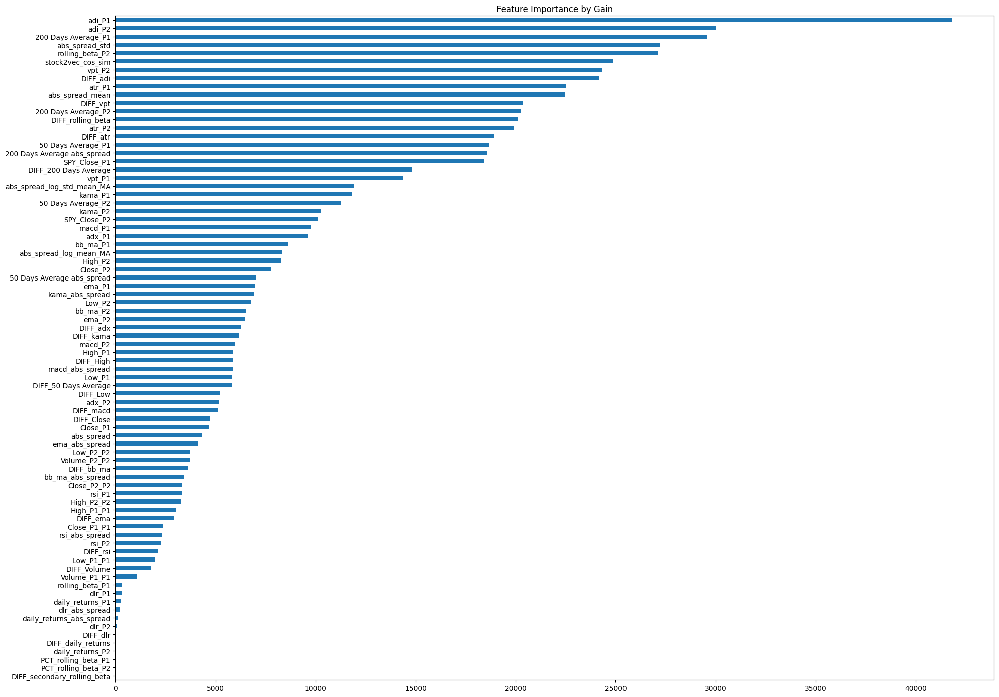

In [90]:
fig,ax=plt.subplots(figsize=[20,14])
importances.plot.barh(ax=ax)
ax.set_title("Feature Importance by Gain")
fig.tight_layout()

In [91]:
inference_result = gbm.predict(X_test)

[LightGBM] [Warning] min_data_in_leaf is set=97, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=97
[LightGBM] [Warning] boosting is set=goss, boosting_type=gbdt will be ignored. Current value: boosting=goss
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.


In [92]:
plot_df = pd.DataFrame(pd.concat([pd.Series(inference_result),y_test]).reset_index(drop=True))
plot_df.columns=['value']
plot_df['color'] = ['preds']*len(inference_result)+['true']*len(y_test)
plot_df.shape

(519922, 2)

In [93]:
px.histogram(plot_df,x='value',color='color')

/opt/tensorflow/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  sf: grouped.get_group(s if len(s) > 1 else s[0])


In [94]:
results = pd.DataFrame({'preds':inference_result,'true':y_test})
results.index = X_test.index
results

,preds,true
421111,3.454,3.669
1218831,5.497,5.513
2711707,5.172,5.206
1805725,3.702,3.694
1765839,4.857,4.826
...,...,...
1931621,2.855,2.886
1937319,3.865,4.140
1943017,5.149,5.168
1868943,3.440,3.530


In [95]:

one_pair = df.loc[X_test.index][(df['Ticker_P1']==df.loc[X_test.index]['Ticker_P1'].iloc[-1])&\
                                (df['Ticker_P2']==df.loc[X_test.index]['Ticker_P2'].iloc[-1])].index
one_pair

/tmp/ipykernel_22184/2669964140.py:1: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



Index([2848460, 2848461, 2848462, 2848463, 2848464, 2848465, 2848466, 2848467,
       2848468, 2848469,
       ...
       2848990, 2848991, 2848992, 2848993, 2848994, 2848995, 2848996, 2848997,
       2848998, 2848999],
      dtype='int64', length=540)

In [96]:
px.line(results.loc[one_pair],results.loc[one_pair].index,y=results.columns)

In [97]:
gbm_mae = (inference_result[:len(y_test)] - y_test).abs().mean()
gbm_mae

0.22656043394702038

In [98]:
inference_result

array([3.45430585, 5.4971162 , 5.17231803, ..., 5.14882711, 3.44030731,
       3.2755327 ])

In [99]:
mae = gbm_mae / y_test.abs().mean()
mae

0.05730751573390702

In [100]:
# stop

# Backtest

In [101]:
df.loc[X_test.index, 'entry_preds'] = entry_preds
df.loc[X_test.index, 'exit_preds'] = exit_preds


In [102]:
# Generate the PNL from predicted spread
from pair_trading_foundations.data_generation import ExecutePairTrading

BacktestData = df.loc[X_test.index]

samples = BacktestData
samples = samples.drop(['Date', 'Ticker_P1', 'Ticker_P2', 'Volume_P1', 'Volume_P2','SPY_Close','Ticker', label]+\
                       ['STOCK2VEC_'+ str(i) + '_P1' for i in range(0,32)]+\
                       ['STOCK2VEC_'+ str(i) + '_P2' for i in range(0,32)],axis=1)
samples = samples.drop(always_exclude,axis=1)
samples = samples.drop(features_to_exclude,axis=1)
# samples['abs_spread_log_mean_MA'] = np.log(samples.abs_spread_mean_MA)
# samples['abs_spread_log_std_mean_MA'] = np.log(samples.abs_spread_std_MA)
# samples = samples.drop(['abs_spread_mean_MA', 'abs_spread_std_MA'],axis=1)


model_input = np.reshape(samples, (samples.shape[0], 1, samples.shape[1])).astype(np.float32)
# inference_result = lstm_model.predict(model_input).flatten()
# inference_result = gbm.predict(samples[X_test.columns])
BacktestData['pred_abs_spread'] = np.exp(inference_result)
BacktestData['z_score'] = (np.log(BacktestData['pred_abs_spread']) / BacktestData['abs_spread_std_MA'])
BacktestData = BacktestData.reset_index(drop=True)
BacktestData = BacktestData.drop(['actual_abs_spread', 'actual_abs_spread_std'], axis=1)
BacktestData 

,Ticker_P1,Date,High_P1,Low_P1,Volume_P1,Close_P1,Ticker_P2,High_P2,Low_P2,Volume_P2,...,STOCK2VEC_29_P2,STOCK2VEC_30_P2,STOCK2VEC_31_P2,stock2vec_cos_sim,entry_label1,exit_label1,entry_preds,exit_preds,pred_abs_spread,z_score
0,OXY,2021-08-11,26.840,26.000,15265600.000,26.285,EOG,69.880,68.020,7844900.000,...,0.009,0.069,-0.096,0.912,0,0,0.000,0.000,31.636,1.047
1,OXY,2021-08-11,26.840,26.000,15265600.000,26.285,DHR,277.199,272.872,2395534.000,...,-0.049,-0.025,-0.003,0.869,1,0,1.000,0.000,243.987,0.283
2,ABT,2021-08-11,123.400,121.350,3683100.000,116.101,ESS,320.570,314.490,236700.000,...,-0.051,0.035,0.245,0.895,0,0,0.000,0.000,176.323,0.458
3,OXY,2021-08-11,26.840,26.000,15265600.000,26.285,ED,77.330,76.470,1522200.000,...,0.099,-0.056,0.213,0.728,0,1,0.000,1.000,40.544,1.082
4,OXY,2021-08-11,26.840,26.000,15265600.000,26.285,CLX,166.750,164.100,1183100.000,...,0.092,0.006,0.151,0.683,0,1,0.000,1.000,128.576,0.866
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
259956,OXY,2023-10-04,61.580,59.340,15878800.000,59.849,WFC,39.110,38.390,14343500.000,...,0.005,-0.018,0.036,0.878,0,0,0.000,1.000,17.370,0.938
259957,OXY,2023-10-04,61.580,59.340,15878800.000,59.849,DHI,104.800,102.800,3115800.000,...,-0.133,0.233,0.049,0.761,0,0,0.000,0.000,47.682,0.459
259958,OXY,2023-10-04,61.580,59.340,15878800.000,59.849,AJG,229.650,225.740,656900.000,...,-0.021,0.008,0.118,0.810,0,0,1.000,0.000,172.229,0.981
259959,OXY,2023-10-04,61.580,59.340,15878800.000,59.849,CTRA,26.290,25.440,7253800.000,...,0.083,0.154,0.077,0.863,0,0,0.000,0.000,31.197,2.280


In [103]:
pnls = []
entry_signal = 2    # Make sure this matches with data pipeline
exit_signal = 0.5   # Make sure this matches with data pipeline
test_len = 60       # Make sure this matches with data pipeline
for idx in tqdm(range(BacktestData.shape[0])):
    if (idx > BacktestData.shape[0]-test_len-1):
        pnls.append(np.nan)
    else:
        current_row = BacktestData.loc[idx]
        result = ExecutePairTrading(current_row.pred_abs_spread,   # Use predicted spread
                                    current_row.abs_spread_std_MA, # Use current std deviation
                                    entry_signal=entry_signal,
                                    exit_signal=exit_signal
                                ).execute(
                                    # Forward window
                                    vec1=BacktestData.loc[(idx+1):(idx+test_len)]['Close_P1'].values,
                                    vec2=BacktestData.loc[(idx+1):(idx+test_len)]['Close_P2'].values,
                                    dates=BacktestData.loc[(idx+1):(idx+test_len)]['Date'].values,
                                    base_fund=100,
                                )

        pnls.append(result.final_pl_pct)

BacktestData['pred_pnls'] = pnls
BacktestData = BacktestData.dropna()

strategy = BacktestData.loc[(abs(BacktestData['z_score']) > 0.95) & (BacktestData['pred_pnls'] > 0)]
strategy

  0%|          | 0/259961 [00:00<?, ?it/s]

,Ticker_P1,Date,High_P1,Low_P1,Volume_P1,Close_P1,Ticker_P2,High_P2,Low_P2,Volume_P2,...,STOCK2VEC_30_P2,STOCK2VEC_31_P2,stock2vec_cos_sim,entry_label1,exit_label1,entry_preds,exit_preds,pred_abs_spread,z_score,pred_pnls
6,ABT,2021-08-11,123.400,121.350,3683100.000,116.101,JNJ,174.470,173.560,4221300.000,...,-0.100,0.082,0.874,0,0,0.000,0.000,43.847,1.509,0.241
8,OXY,2021-08-11,26.840,26.000,15265600.000,26.285,APH,73.770,73.310,1313300.000,...,-0.011,0.077,0.847,0,0,1.000,0.000,44.908,1.143,0.277
19,OXY,2021-08-11,26.840,26.000,15265600.000,26.285,SPG,134.070,131.170,1415800.000,...,0.046,0.163,0.844,1,0,1.000,0.000,87.634,1.444,2.161
22,ABT,2021-08-11,123.400,121.350,3683100.000,116.101,IPG,37.590,36.720,2736100.000,...,0.098,-0.013,0.825,0,0,0.000,0.000,64.455,0.997,0.274
26,OXY,2021-08-11,26.840,26.000,15265600.000,26.285,SO,66.000,65.210,3452600.000,...,-0.051,0.227,0.736,0,0,0.000,0.000,30.271,1.090,0.369
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
259880,OXY,2023-10-04,61.580,59.340,15878800.000,59.849,LIN,379.880,372.760,1897900.000,...,-0.045,-0.035,0.869,0,0,0.000,0.000,287.852,1.038,0.464
259887,OXY,2023-10-04,61.580,59.340,15878800.000,59.849,GILD,74.820,73.250,4707600.000,...,-0.036,-0.042,0.769,0,0,0.000,0.000,18.978,1.110,0.416
259895,OXY,2023-10-04,61.580,59.340,15878800.000,59.849,DUK,86.410,84.870,3322900.000,...,-0.026,0.213,0.761,0,0,0.000,1.000,24.561,1.161,0.318
259896,OXY,2023-10-04,61.580,59.340,15878800.000,59.849,WELL,81.740,79.560,2970100.000,...,0.105,0.201,0.828,0,0,1.000,0.000,22.083,1.768,0.318


In [104]:
# strategy = BacktestData.loc[(abs(BacktestData['z_score']) > 0.95) & (BacktestData['pred_pnls'] > 0)]
strategy = BacktestData.iloc[:-150000]

In [105]:
print(strategy.shape)
strategy = strategy[strategy['entry_preds']==1]
print(strategy.shape)


(109901, 159)
(29241, 159)


In [106]:
print(strategy.shape)
strategy = strategy[strategy['exit_preds']==1]
print(strategy.shape)


(29241, 159)
(209, 159)


In [107]:
print(strategy.shape)
strategy = strategy[strategy['stock2vec_cos_sim']>=0.8]
print(strategy.shape)



(209, 159)
(184, 159)


In [108]:
BacktestData.iloc[:-150000].Date.min(),BacktestData.iloc[:-150000].Date.max()

(datetime.date(2021, 8, 11), datetime.date(2022, 7, 11))

In [109]:
if len(strategy):
    pnl_filters = strategy.filter(items=['Date', 'pnls', 'pred_pnls'])
    pnl_filters = pnl_filters.rename(columns={'pnls': 'actual_PNLS', 'pred_pnls': 'predicted_PNLS'})
#     ax = pnl_filters.plot(x='Date',y=['predicted_PNLS'],  linestyle='-', marker='o', color='red')
#     pnl_filters.plot(x='Date',y=['actual_PNLS'], kind='bar', ax=ax)
#     ax.set_title('Predicted pnls over actual')
#     plt.figure(figsize=(8,6))
#     plt.show()
else:
    print('No valid entry available')

In [110]:
# Strategy 1: Execute each recommended trade by X amount
if len(strategy):
    average_pnl = pnl_filters.actual_PNLS.sum() / len(pnl_filters.actual_PNLS)
    print('Returns: ', average_pnl)

Returns:  0.011224234287327354


In [111]:
# Strategy 2: Execute top 10 recommended trade by X amount
if len(strategy):
    best_num = 10
    pnl_filters = pnl_filters.reset_index(drop=True)
    # Get the top 10 predictions for PNL
    sorted_indices = pnl_filters.predicted_PNLS.argsort()[::-1]
    top_k = sorted_indices[sorted_indices < best_num]

    # Retrieve the actual PNL
    average_pnl = pnl_filters.actual_PNLS[top_k].sum() / best_num
    print('Returns: ', average_pnl)

Returns:  0.07719052369186048


In [112]:
# Normality test

from scipy.stats import shapiro
# normality test
stat, p = shapiro(inference_result)
print('Statistics=%.3f, p=%.3f' % (stat, p))
# interpret
alpha = 0.05
if p > alpha:
    print('Sample looks Gaussian (fail to reject H0)')
else:
    print('Sample does not look Gaussian (reject H0)')

Statistics=0.992, p=0.000
Sample does not look Gaussian (reject H0)


/tmp/ipykernel_22184/3367852916.py:5: UserWarning:

scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 259961.



In [113]:
# D’Agostino’s K^2 Test
from scipy.stats import normaltest
# normality test
stat, p = normaltest(inference_result)
print('Statistics=%.3f, p=%.3f' % (stat, p))
# interpret
alpha = 0.05
if p > alpha:
    print('Sample looks Gaussian (fail to reject H0)')
else:
    print('Sample does not look Gaussian (reject H0)')

Statistics=9210.132, p=0.000
Sample does not look Gaussian (reject H0)


In [114]:
# Anderson-Darling Test
from scipy.stats import anderson
result = anderson(inference_result)
print('Statistic: %.3f' % result.statistic)
p = 0
for i in range(len(result.critical_values)):
    sl, cv = result.significance_level[i], result.critical_values[i]
if result.statistic < result.critical_values[i]:
    print('%.3f: %.3f, data looks normal (fail to reject H0)' % (sl, cv))
else:
    print('%.3f: %.3f, data does not look normal (reject H0)' % (sl, cv))

Statistic: 421.908
1.000: 1.092, data does not look normal (reject H0)
